# Homework 2 (100 Points)

The goal of this homework is to get more practice with pandas and get practice with clustering on various datasets.

### Collaborators:  Sarah Bonna,Shivangi

## Exercise 1 - (50 points)

This exercise will be using the [Airbnb dataset](http://insideairbnb.com/get-the-data.html) for NYC called `listings.csv`. You can download it directly [here](http://data.insideairbnb.com/united-states/ny/new-york-city/2021-11-02/visualisations/listings.csv)

a) Produce a Heatmap using the Folium package (you can install it using pip) of the mean listing price per location (lattitude and longitude) over the NYC map. (5 points)

Hints:
1. generate a base map of NYC to plot over: default_location=[40.693943, -73.985880] 
2. generate an HTML file named `index.html` - open it in your browser and you'll see the heatmap

In [1]:
import pandas as pd
import numpy as np
from folium import plugins, Map, Circle
from folium.plugins import HeatMap

df = pd.read_csv("listings.csv")
base_map = Map()

df['latitude'] = df['latitude'].astype(float)
df['longitude'] = df['longitude'].astype(float)
df['price'] = df['price'].astype(float)
mean = df.groupby(['latitude', 'longitude'], as_index=False)['price'].mean()
HeatMap(mean).add_to(base_map)
base_map.save("index.html")

/var/folders/8t/xtz7fzyn6_gg4jxvqj42whvh0000gn/T/ipykernel_32228/1377378782.py:6: DtypeWarning: Columns (17) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("listings.csv")


b) Plot a bar chart of the average price per room type. Briefly comment on the relation between price and room type. - (2.5 pts)


<AxesSubplot:xlabel='room_type'>

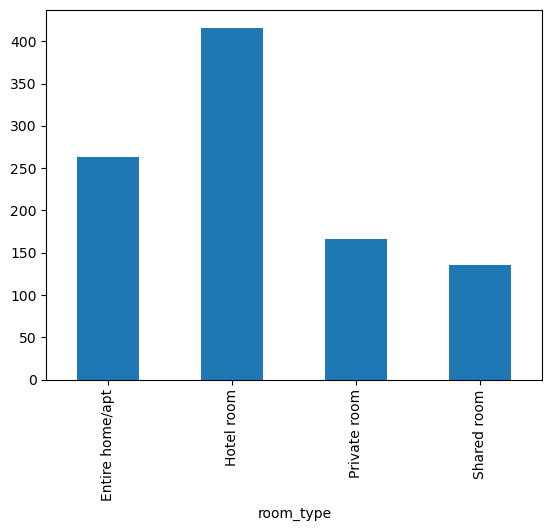

In [2]:
df.groupby("room_type").price.mean().plot(kind="bar")

-> The average price of hotel room is the highest due to the amenities and location compared to shared room and private room.

c) Plot on the NYC map the top 10 most reviewed listings (Note: some could be in the same location) - (5 pts)


In [3]:
from folium import Marker

base_map = Map()

df['latitude'] = df['latitude'].astype(float)
df['longitude'] = df['longitude'].astype(float)
df['price'] = df['price'].astype(float)
ten_most_reviewed = df.nlargest(10, 'number_of_reviews')
heat_data = [[row['latitude'],row['longitude'], row['number_of_reviews'], row['name']] for index, row in ten_most_reviewed.iterrows()]
for i in range(0,len(heat_data)): 
    Marker(
      location=[heat_data[i][0], heat_data[i][1]],
      popup=heat_data[i][2]).add_to(base_map)
base_map.save("q1c.html")

d) Using `longitude`, `latitude`, `price`, and `number_of_reviews`, use Kmeans to create 5 clusters. Plot the points on the NYC map in a color corresponding to their cluster. - (15 points)


In [4]:
from sklearn.cluster import KMeans
from matplotlib.pyplot import figure
import matplotlib.pyplot as plt
from folium import CircleMarker
clustering_data = df
kmeans = KMeans(n_clusters=5)
kmeans = kmeans.fit(clustering_data[['longitude','latitude','price','number_of_reviews']])
clusters = kmeans.cluster_centers_
labels = kmeans.fit_predict(clustering_data[['longitude','latitude','price','number_of_reviews']])
u_labels = np.unique(labels)

clustering_data.loc[:,'label'] = kmeans.labels_
di = {0: "cyan",1: "green", 2: "black",3: "yellow", 4: "magenta"}
clustering_data["label"].replace(di, inplace=True)
points = [[row['latitude'],row['longitude']] for index, row in clustering_data.iterrows()]
colors = [[row['label']] for index, row in clustering_data.iterrows()]
reviews = [[row['number_of_reviews']] for index, row in clustering_data.iterrows()]
base_map = Map()

for point in range(0, len(points)):
    CircleMarker(radius=10,location=points[point], color=colors[point], fill=False, popup=reviews[point]).add_to(base_map)
base_map.save("q1d.html")    

e) You should see points in the same cluster all over the map (i.e. not really clustered together...) - briefly explain why that is. - (2.5 points)

-> Kmeans clustering is used for data which is continuous data. But, latitude and logitude are discreete data, are used along with contunuous data like price and number of reviewes, which doesn't create meaningful clusters.

f) How many clusters would you recommend using instead of 5? Display and interpret either the silhouette scores or the elbow method. - (5 points)

-> 10, 11 or 12 clusters should be chosen as we can see from the silhouette score plots from 2 to 12 clusters, that they give the most even distribution of clusters amongst other cluster numbers.

For clusters = 2 The average silhouette score is : 0.8398580510575818
For clusters = 3 The average silhouette score is : 0.796005371813685
For clusters = 4 The average silhouette score is : 0.7688817790881046
For clusters = 5 The average silhouette score is : 0.7407666215644496
For clusters = 6 The average silhouette score is : 0.7342809904028358
For clusters = 7 The average silhouette score is : 0.7144493081068687
For clusters = 8 The average silhouette score is : 0.6763858764259797
For clusters = 9 The average silhouette score is : 0.6805553827620294
For clusters = 10 The average silhouette score is : 0.6459662137701726
For clusters = 11 The average silhouette score is : 0.6532772793845809
For clusters = 12 The average silhouette score is : 0.6275707778039957


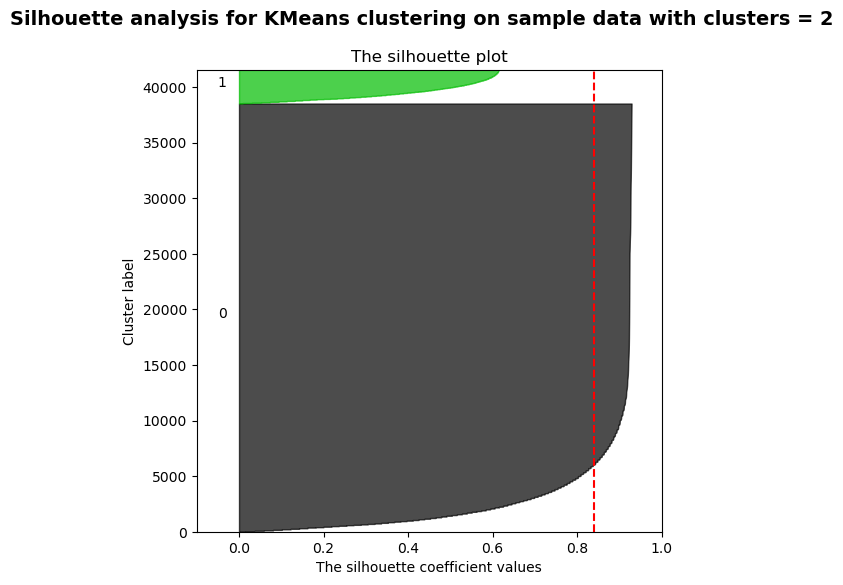

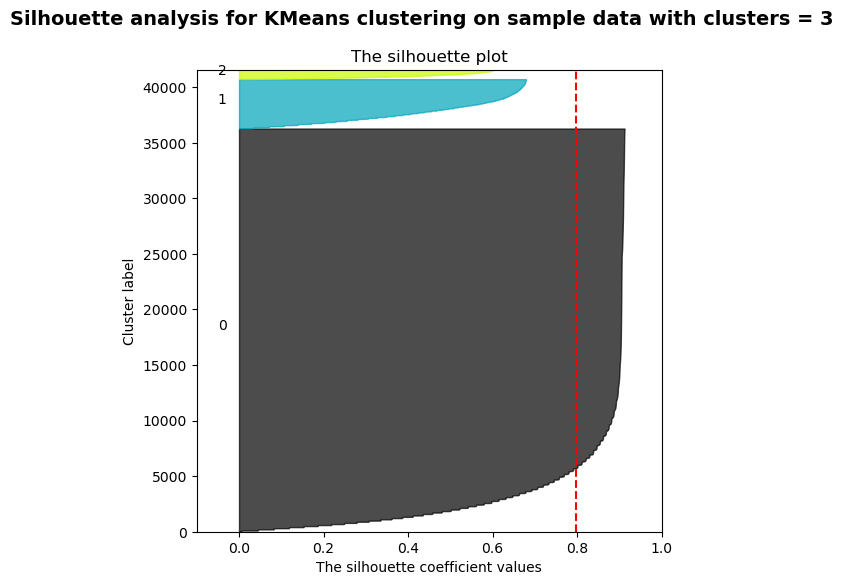

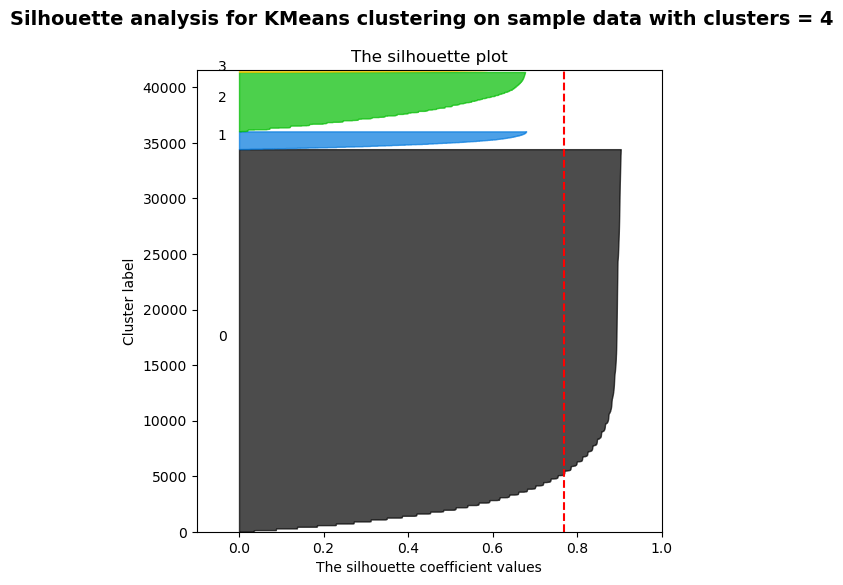

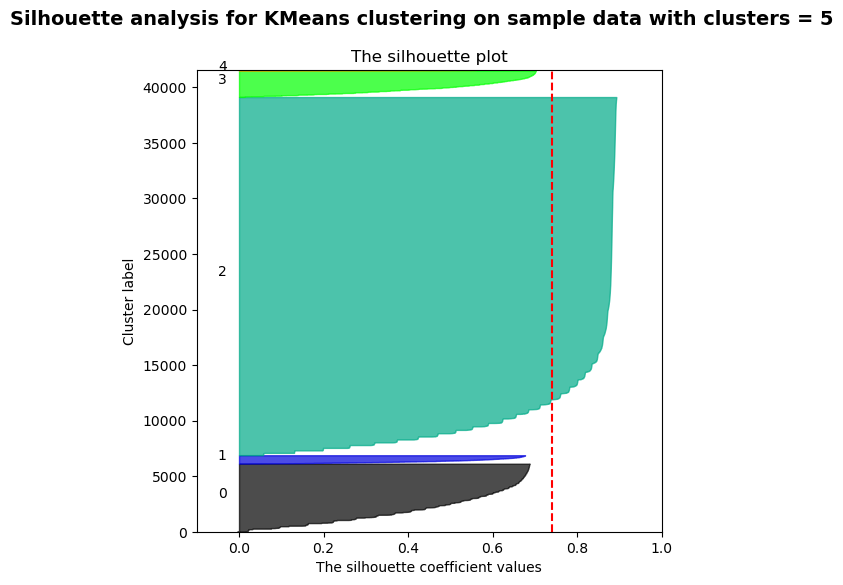

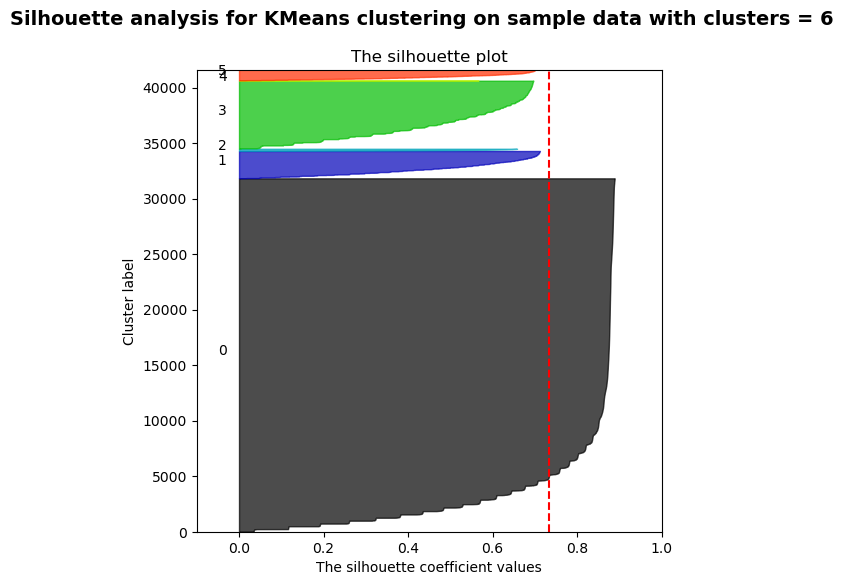

...

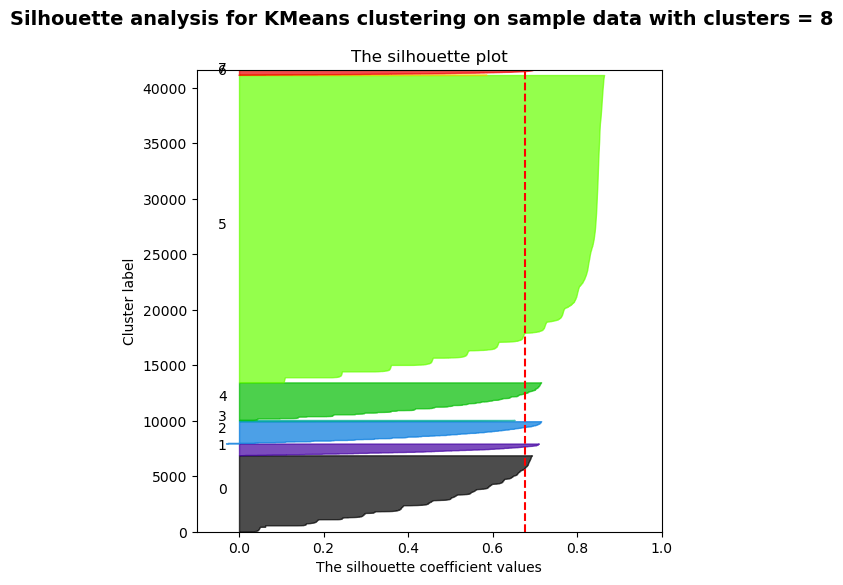

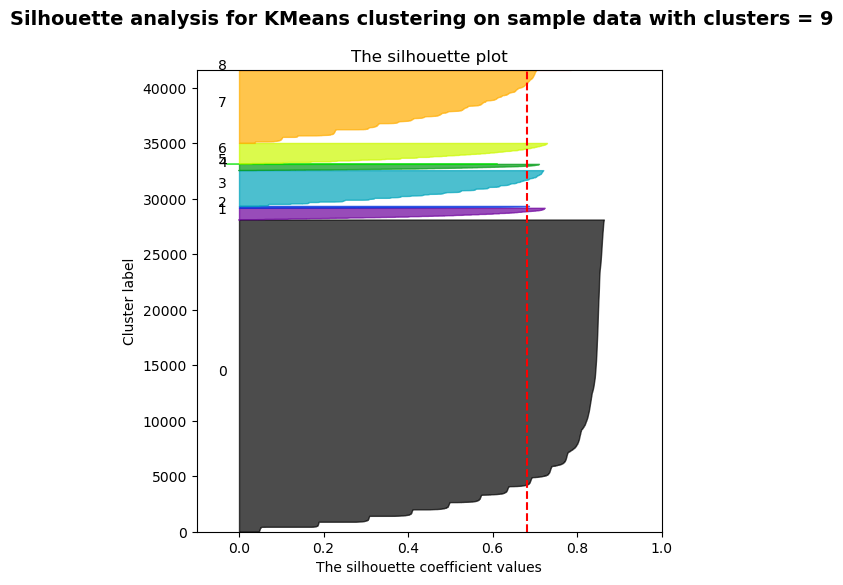

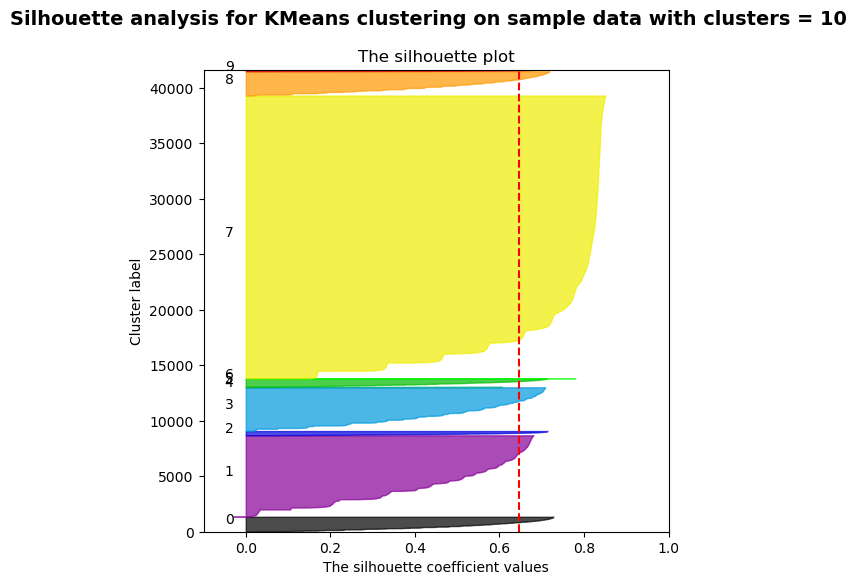

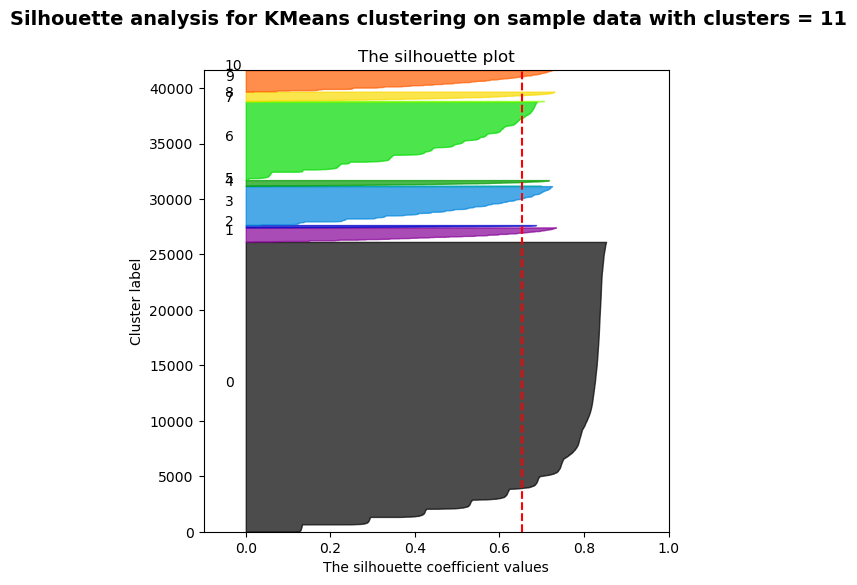

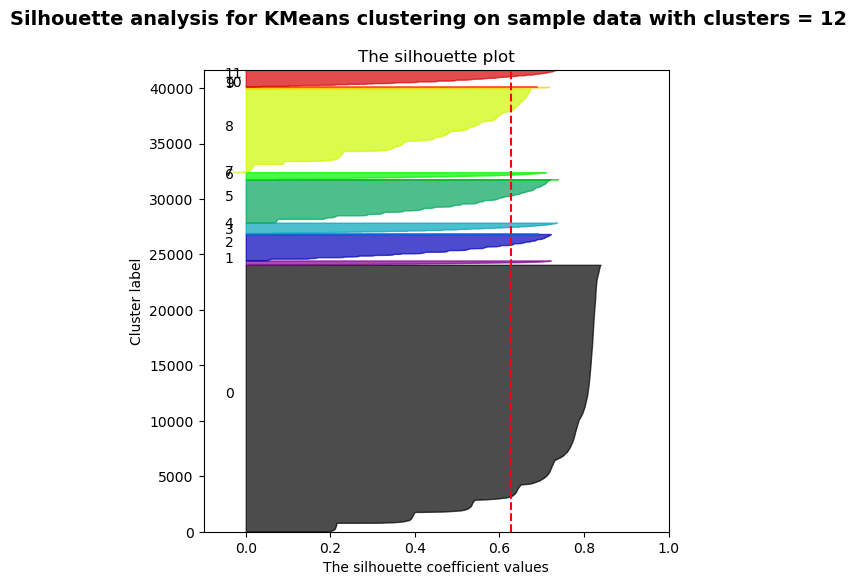

In [13]:
import sklearn.metrics as metrics
import matplotlib.cm as cm

test_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]

for c in test_clusters:
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches(6, 6)
    ax.set_xlim([-0.1, 1])
    ax.set_ylim([0, len(clustering_data[['longitude','latitude','price','number_of_reviews']]) + (c + 1) * 10])
    kmeans = KMeans(n_clusters=c, random_state=10)
    cluster_labels = kmeans.fit_predict(clustering_data[['longitude','latitude','price','number_of_reviews']])
    silhouette_avg = metrics.silhouette_score(clustering_data[['longitude','latitude','price','number_of_reviews']], cluster_labels)
    print("For clusters =", c, "The average silhouette score is :", silhouette_avg,)
    sample_silhouette_values = metrics.silhouette_samples(clustering_data[['longitude','latitude','price','number_of_reviews']], cluster_labels)
    y_lower = 10
    for i in range(c):
        ith_cluster_sv = sample_silhouette_values[cluster_labels == i]
        ith_cluster_sv.sort()
        size_cluster_i = ith_cluster_sv.shape[0]
        y_upper = y_lower + size_cluster_i
        color = cm.nipy_spectral(float(i) / c)
        ax.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_sv,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )
        ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        y_lower = y_upper + 10
    ax.set_title("The silhouette plot")
    ax.set_xlabel("The silhouette coefficient values")
    ax.set_ylabel("Cluster label")
    ax.axvline(x=silhouette_avg, color="red", linestyle="--")
    plt.suptitle("Silhouette analysis for KMeans clustering on sample data with clusters = %d" % c, fontsize=14, fontweight="bold",)
plt.show()

g) For all listings of type `Shared room`, plot the dendrogram of the hierarchical clustering generated from `longitude`, `latitude`, and `price`. You can use any distance function. - (10 points)

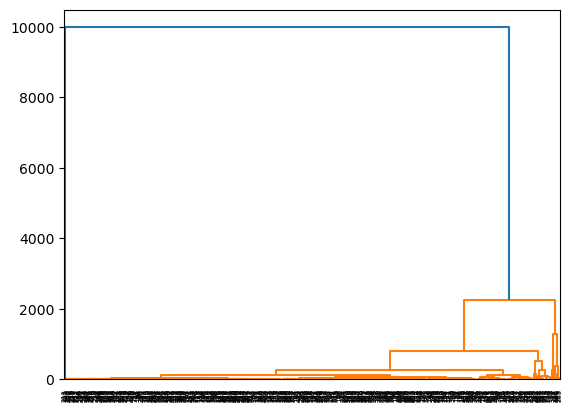

In [9]:
from scipy.cluster import hierarchy
from scipy.spatial.distance import pdist, squareform

c_link=hierarchy.linkage(pdist(df[df["room_type"]=="Shared room"][['longitude','latitude','price']]), metric='euclidean', method='complete')
beach = hierarchy.dendrogram(c_link)

h) Normalize `longitude`, `latitude`, and `price` by subtracting by the mean (of the column) and dividing by the standard deviation (of the column). Repeat g) using the normalized data. Comment on what you observe. - (5 points)

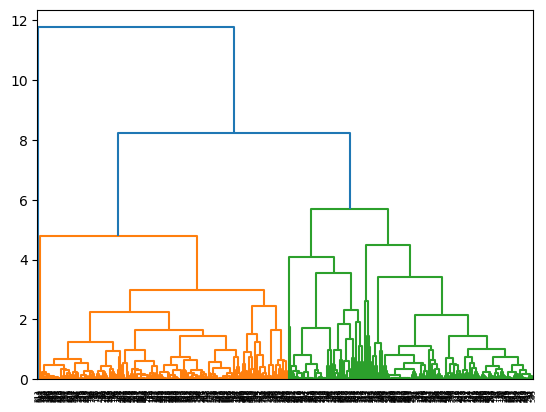

In [10]:
hdf = df
hdf['longitude']= (hdf['longitude']-hdf['longitude'].mean())/hdf['longitude'].std()
hdf['latitude']= (hdf['latitude']-hdf['latitude'].mean())/hdf['latitude'].std()
hdf['price']= (hdf['price']-hdf['price'].mean())/hdf['price'].std()

c_link=hierarchy.linkage(pdist(hdf[hdf["room_type"]=="Shared room"][['longitude','latitude','price']]), metric='euclidean', method='complete')
beach = hierarchy.dendrogram(c_link)

-> Normalizing the values ensure that the dendrogram falls under the same range, removing skewness in the graph, making it more easy to visualize

## Exercise 2 (50pts)

Re-using the dbscan code written in class, reproduce the following animation of the dbscan algorithm

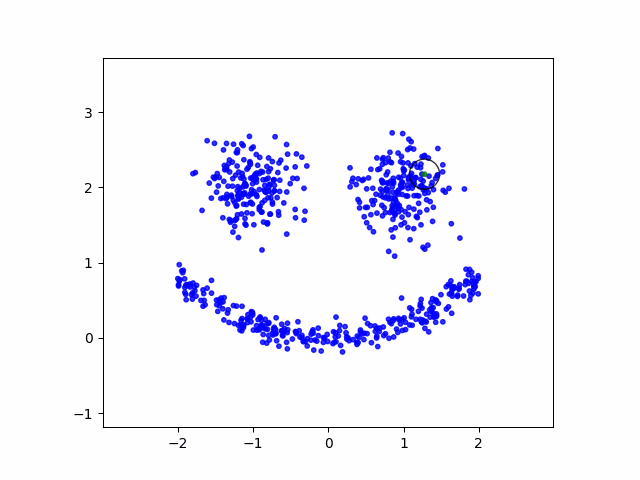

In [11]:
from IPython.display import Image
Image(filename="dbscan.gif", width=500, height=500)

Hints:

- First animate the dbscan algorithm for the dataset used in class (before trying to create the above dataset)
- Take a snapshot of the assignments when the point gets assigned to a cluster
- Confirm that the snapshot works by saving it to a file
- Don't forget to close the matplotlib plot after saving the figure
- Gather the snapshots in a list of images that you can then save as a gif using the code below
- Use `ax.set_aspect('equal')` so that the circles don't appear to be oval shaped
- To create the above dataset you need two blobs for the eyes. For the mouth you can use the following process to generate (x, y) pairs:
  - Pick an x at random in an interval that makes sense given where the eyes are positioned
  - For that x generate y that is 0.2 * x^2 plus a small amount of randomness
  - `zip` the x's and y's together and append them to the dataset containing the blobs



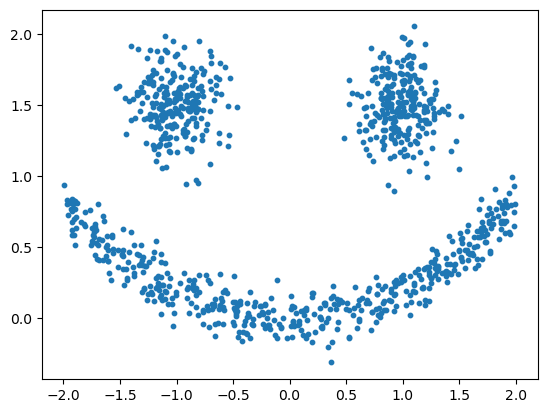

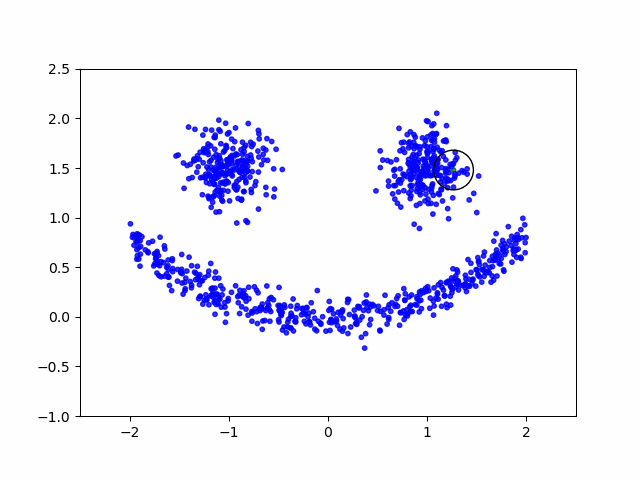

In [12]:
import numpy as np
from PIL import Image as im
import matplotlib.pyplot as plt
import sklearn.datasets as datasets

TEMPFILE = 'temp.png'

class DBC():

    def __init__(self, dataset, min_pts, epsilon):
        self.dataset = dataset
        self.min_pts = min_pts 
        self.epsilon = epsilon
        self.snaps = []
        self.assignments = [0 for _ in range(len(self.dataset))]


    def snapshot(self, curr_pos):
        fig, ax = plt.subplots()
        colors = np.array([x for x in 'bgrcmykbgrcmykbgrcmykbgrcmyk'])
        colors = np.hstack([colors] * 30)

        ax.scatter(self.dataset[:, 0], self.dataset[:, 1], c=colors[self.assignments], s=10, alpha=0.8)
        cir = plt.Circle((self.dataset[curr_pos][0], self.dataset[curr_pos][1]), 0.2, color='k', fill=False) # create circle around the point assigned
        ax.add_patch(cir)
        ax.set_xlim(-2.5, 2.5)
        ax.set_ylim(-1,2.5)
        ax.set_aspect('equal') # necessary or else the circles appear to be oval shaped

        fig.savefig(TEMPFILE)
        plt.close()

        return im.fromarray(np.asarray(im.open(TEMPFILE)))

    def is_core(self, i):
        neighbors=[]
        for j in range(len(self.dataset)):
            if i != j and np.linalg.norm(self.dataset[i] - self.dataset[j]) <= self.epsilon:
                neighbors.append(j)
        return len(neighbors) >= self.min_pts
    
    def get_unlabeled_neighborhood(self, i):
        neighbors=[]
        for j in range(len(self.dataset)):
            if i != j and self.assignments[j] == 0 and np.linalg.norm(self.dataset[i] - self.dataset[j]) <= self.epsilon:
                neighbors.append(j)
        return neighbors
    
    def dfs_assignment(self, i, cluster_number):
        self.assignments[i] = cluster_number
        self.snaps.append(self.snapshot(i))
        neighbors = self.get_unlabeled_neighborhood(i)
        while neighbors:
            next_neighbor = neighbors.pop()
            if self.assignments[next_neighbor] == 0:
                self.assignments[next_neighbor] = cluster_number
                self.snaps.append(self.snapshot(next_neighbor))
                if self.is_core(next_neighbor):
                    neighbors += self.get_unlabeled_neighborhood(next_neighbor)
        

    def dbscan(self):
        """
        returns a list of assignments. The index of the
        assignment should match the index of the data point
        in the dataset.
        """
        # init assignments with all dataset points to 0 i.e unlabeled
        cluster_number = 1
        for i in range(len(self.dataset)):
            if self.is_core(i) and self.assignments[i] == 0:
                self.dfs_assignment(i, cluster_number)
            cluster_number +=1    
        return self.assignments


centers = [[-1, 1.5], [1, 1.5]]
eyes, _ = datasets.make_blobs(n_samples=500, centers=centers, random_state=0, cluster_std=0.2)

mouth_x = -2 + 4 * np.random.random(size=(500,))
mouth_y = 0.2 * mouth_x**2 + 0.1 * np.random.randn(500)

face = np.append(eyes, list(zip(mouth_x, mouth_y)), axis=0)

plt.scatter(face[:,0],face[:,1],s=10)
plt.show()

dbc = DBC(face, 3, .2)
clustering = dbc.dbscan()

dbc.snaps[0].save(
    'dbscan_answer.gif',
    optimize=False,
    save_all=True,
    append_images=dbc.snaps[1:],
    loop=0,
    duration=25
)

Image(filename="dbscan_answer.gif", width=500, height=500)